# Code

In [1]:
%matplotlib inline

## Imports

In [2]:
import os
import pathlib

import einops
import IPython.display
import matplotlib.pyplot as plt
import numpy
import torch
import torchvision
import tqdm

## Display

In [3]:
def save_gif(images, path, duration=10):
    images[0].save(
        path,
        save_all=True,
        append_images=images[1:],
        duration=duration,
        loop=0,
    )


def display_tensor_list(tensor_list: list[torch.Tensor]) -> None:
    grid = torchvision.utils.make_grid(tensor_list, nrow=8)
    grid_img = torchvision.transforms.ToPILImage()(grid)
    display(grid_img)

## Losses

In [4]:
def get_style_loss(target: torch.Tensor, params: dict):
    # Build style loss from specific target tensor
    target_styles = vgg_styles(target, params)

    def style_loss(x: torch.Tensor, n: int) -> torch.Tensor:
        x_styles = vgg_styles(x, params)
        return sum(
            opt_transport_loss(x, y[n].unsqueeze(0))
            for (x, y) in zip(x_styles, target_styles)
        )

    return style_loss


def vgg_styles(x: torch.Tensor, params: dict) -> list[torch.Tensor]:
    # Extract features from a tensor
    x = params["transform"](x)
    features = [x]
    for i, layer in enumerate(params["model"][: max(params["layers"]) + 1]):
        x = layer(x)
        if i in params["layers"]:
            features.append(x)
    return features


def opt_transport_loss(
    source: torch.Tensor, target: torch.Tensor, proj_dim: int = 32
) -> torch.Tensor:
    # Sliced wasserstein loss (optimal transport) https://arxiv.org/pdf/2006.07229.pdf
    source = source.flatten(-2)
    target = target.flatten(-2)
    c, f = source.shape[-2:]
    style_w = torch.nn.functional.normalize(torch.randn(c, proj_dim), dim=0)
    source_proj = torch.einsum("bcf,cp->bpf", source, style_w).sort()[0]
    target_proj = torch.einsum("bcf,cp->bpf", target, style_w).sort()[0]
    target_proj = torch.nn.functional.interpolate(target_proj, f, mode="nearest")
    loss = (source_proj - target_proj.detach()).square().sum()
    return loss


def overflow_loss(x: torch.Tensor) -> torch.Tensor:
    loss = (x - x.clamp(-1.0, 1.0)).abs().sum()
    return loss

## Model

### Perception & Evolution

In [5]:
class Perception(torch.nn.Module):
    def __init__(self) -> None:
        super().__init__()

        Ki = torch.tensor([[0, 0, 0], [0, 1, 0], [0, 0, 0]])
        Kx = torch.tensor([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]])
        Klap = 0.25 * torch.tensor([[1, 2, 1], [2, -12, 2], [1, 2, 1]])

        self.register_buffer("filters", torch.stack([Ki, Kx, Kx.T, Klap])[:, None])

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        c = x.shape[1]
        x = einops.rearrange(x, "b s h w -> (b s) () h w")
        x = torch.nn.functional.pad(x, [1, 1, 1, 1], "circular")  # Keep same size
        x = torch.nn.functional.conv2d(x, self.filters)
        x = einops.rearrange(x, "(b s) k h w -> b (k s) h w", k=4, s=s)
        return x


class Evolution(torch.nn.Module):
    def __init__(self, ns: int, ng: int) -> None:
        super().__init__()

        self.conv1 = torch.nn.Conv2d(4 * ns + ng, 2 * 4 * ns, kernel_size=1)
        self.conv2 = torch.nn.Conv2d(2 * 4 * ns, ns, kernel_size=1, bias=False)
        self.conv2.weight.data.zero_()

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        ds = self.conv2(torch.relu(self.conv1(x)))
        return ds

### Goal

In [6]:
class Goal(torch.nn.Module):
    def __init__(self, n_goal: int, embed_dim: int) -> None:
        super().__init__()
        self.embedding = torch.nn.Embedding(n_goal, embed_dim)
        self.norm = torch.nn.LayerNorm(embed_dim)
        self.ffwd = torch.nn.Sequential(
            torch.nn.Linear(embed_dim, 4 * embed_dim),
            torch.nn.ReLU(),
            torch.nn.Linear(4 * embed_dim, embed_dim),
        )

    def forward(self, i: torch.Tensor) -> torch.Tensor:
        x = self.embedding(i)
        x = self.ffwd(self.norm(x)) + x
        return x

### Cellular Automata

In [7]:
class CellularAutomata(torch.nn.Module):
    def __init__(self, ns: int, ng: int) -> None:
        super().__init__()

        self.perception = Perception()
        self.evolution = Evolution(ns, ng)

    def forward(self, s: torch.Tensor, xg: torch.Tensor) -> torch.Tensor:
        xs = self.perception(s)
        x = torch.cat([xs, xg], dim=1)
        ds = self.evolution(x)
        update_mask = torch.randn_like(x[:, :1, :, :]) > 0

        return s + ds * update_mask

# Experiment

## Setup

In [8]:
numpy.random.seed(21)
torch.manual_seed(94)
torch.set_default_device("cuda" if torch.cuda.is_available() else "cpu")
torch.set_default_tensor_type("torch.cuda.FloatTensor")

DATASET_DIR = os.getenv("DATASET_DIR")
MODEL_DIR = os.getenv("MODEL_DIR")
N_EPOCH = int(os.getenv("N_EPOCH"))
N_EXP = int(os.getenv("N_EXP"))
print("N_EPOCH: ", N_EPOCH)
print("N_EXP: ", N_EXP)

b, s, h, w = tuple(eval(os.getenv("BSHW")))
g = int(os.getenv("G"))
print("b, s, h, w: ", b, s, h, w)
print("g: ", g)

N_EPOCH:  5000
N_EXP:  6
b, s, h, w:  128 12 48 48
g:  12


In [ ]:
save_dir = pathlib.Path(f"{MODEL_DIR}") / "6_textures"
save_dir.mkdir(parents=True, exist_ok=True)
checkpoint = None

## Dataset

In [10]:
dataset_transform = torchvision.transforms.Compose(
    [torchvision.transforms.ToTensor(), torchvision.transforms.CenterCrop((h, w))]
)

train_dataset = torchvision.datasets.DTD(
    root=DATASET_DIR, transform=dataset_transform, download=True
)
dataset_sample = [train_dataset[110 * i][0] for i in range(N_EXP - 1)] + [
    train_dataset[1][0]
]

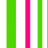

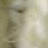

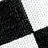

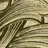

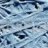

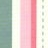

In [11]:
style_params = {
    "model": torchvision.models.vgg16(weights="IMAGENET1K_V1").features,
    "layers": [1, 6, 11, 18, 25],
    "transform": torchvision.transforms.Normalize(
        [0.485, 0.456, 0.406], [0.229, 0.224, 0.225]
    ),
}
style_tensor = torch.stack(dataset_sample)
style_tensor = style_tensor.to(torch.device("cuda"))
for i, x in enumerate(dataset_sample):
    style_img = torchvision.transforms.ToPILImage()(x)
    style_img.save(save_dir / f"texture_{i}.png")
    display(style_img)

texture_loss = get_style_loss(style_tensor, style_params)

In [12]:
ca = CellularAutomata(s, g)
optimizer = torch.optim.Adam(ca.parameters(), lr=1e-3, capturable=True)
lr_sched = torch.optim.lr_scheduler.MultiStepLR(optimizer, [1000, 2000], 0.3)
print(ca)
print("N parameters:", sum(p.numel() for p in ca.parameters()))

goal = Goal(N_EXP, g)
g_optimizer = torch.optim.Adam(goal.parameters(), lr=1e-3, capturable=True)
glr_sched = torch.optim.lr_scheduler.MultiStepLR(g_optimizer, [1000, 2000], 0.3)
print(goal)
print("N parameters:", sum(p.numel() for p in goal.parameters()))

pool = torch.zeros((N_EXP, b, s, h, w))

CellularAutomata(
  (perception): Perception()
  (evolution): Evolution(
    (conv1): Conv2d(60, 96, kernel_size=(1, 1), stride=(1, 1))
    (conv2): Conv2d(96, 12, kernel_size=(1, 1), stride=(1, 1), bias=False)
  )
)
N parameters: 7008
Goal(
  (embedding): Embedding(6, 12)
  (norm): LayerNorm((12,), eps=1e-05, elementwise_affine=True)
  (ffwd): Sequential(
    (0): Linear(in_features=12, out_features=48, bias=True)
    (1): ReLU()
    (2): Linear(in_features=48, out_features=12, bias=True)
  )
)
N parameters: 1308


## Training

100%|██████████| 5000/5000 [31:04<00:00,  2.68it/s]


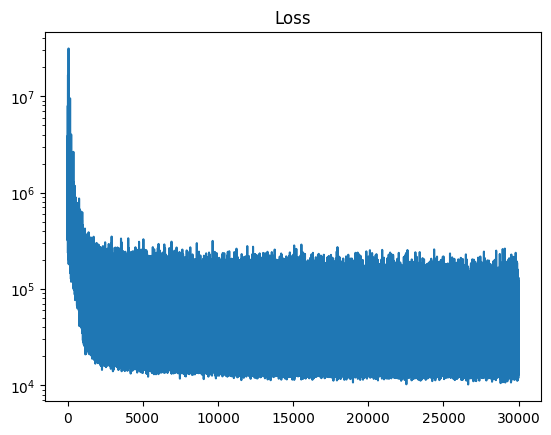

In [13]:
if checkpoint is not None:
    ca.load_state_dict(checkpoint["ca"])
    goal.load_state_dict(checkpoint["goal"])
else:
    losses = []
    for i in tqdm.trange(N_EPOCH):
        for n in range(N_EXP):
            g = torch.Tensor(4 * [n]).to(torch.int64)
            xg = einops.repeat(goal(g), "b g -> b g h w", h=h, w=w)

            batch_idx = numpy.random.choice(b, 4, replace=False)
            x = pool[n, batch_idx]
            if i % 8 == 0:
                x[:1] = 0
            step_n = numpy.random.randint(32, 96)
            for k in range(step_n):
                x = ca(x, xg)

            loss = texture_loss(x[:, :3] + 0.5, n) + overflow_loss(x)
            loss.backward()

            for p in ca.parameters():
                p.grad /= p.grad.norm() + 1e-8
            optimizer.step()
            optimizer.zero_grad()
            lr_sched.step()

            for p in goal.parameters():
                p.grad /= p.grad.norm() + 1e-8
            g_optimizer.step()
            g_optimizer.zero_grad()
            glr_sched.step()

            pool[n, batch_idx] = x.detach()

            losses.append(loss.item())

    torch.save(
        {"ca": ca.state_dict(), "goal": goal.state_dict()}, f"{save_dir}/model.pt"
    )

    plt.plot(losses)
    plt.title("Loss")
    plt.yscale("log")

## Results

#### Gifs for each textures

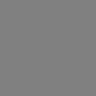

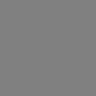

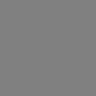

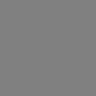

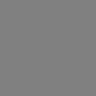

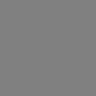

In [14]:
to_display = []
for n in range(N_EXP):
    with torch.no_grad():
        g = torch.Tensor([n]).to(torch.int64)
        xg = einops.repeat(goal(g), "b g -> b g h w", h=2 * h, w=2 * w)
        st = torch.zeros((1, s, 2 * h, 2 * w))

        imgs = []
        for i in range(2000):
            if i % 10 == 0:
                imgs.append(torchvision.transforms.ToPILImage()(st[0, :3] + 0.5))
            st = ca(st, xg)

    save_gif(imgs, save_dir / f"generation_{n}.gif")
    to_display.append(IPython.display.Image(save_dir / f"generation_{n}.gif"))

display(*to_display)

#### Gifs for each pair of textures

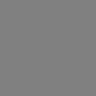

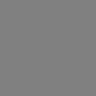

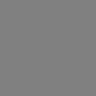

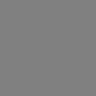

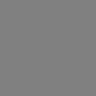

...

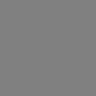

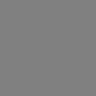

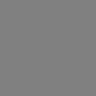

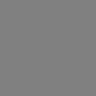

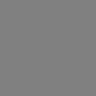

In [15]:
to_display = []
wei = torch.Tensor([0.5, 0.5])
for a in range(N_EXP - 1):
    for b in range(a + 1, N_EXP):
        with torch.no_grad():
            g = goal(torch.Tensor([a, b]).to(torch.int64))
            g = wei @ g
            xg = einops.repeat(g.unsqueeze(0), "b g -> b g h w", h=2 * h, w=2 * w)
            st = torch.zeros((1, s, 2 * h, 2 * w))

            imgs = []
            for i in range(2000):
                if i % 20 == 0:
                    imgs.append(torchvision.transforms.ToPILImage()(st[0, :3] + 0.5))
                st = ca(st, xg)

        save_gif(imgs, save_dir / f"generation_{a}{b}.gif")
        to_display.append(IPython.display.Image(save_dir / f"generation_{a}{b}.gif"))

display(*to_display)